# Used Car Prices CarGurus: XGBoost Set Params Same GPU + CUML
## Weights & Biases Optuna Hyperparameter Optimization

## Set Up Environment, Read Data, Prepare for Modeling

In [ ]:
# Install/import dependencies
!pip install --upgrade pip
!pip install xgboost==1.5.2
!pip install --upgrade -q wandb
!pip install optuna
!pip install plotly
!pip install shap
!pip install eli5
import os
import warnings
import random
import numpy as np
import cupy 
from cupy import asnumpy
import dask
from dask.distributed import Client, wait
from dask.diagnostics import ProgressBar
from dask_cuda import LocalCUDACluster
import dask_cudf
import urllib.request
from contextlib import contextmanager
import time
from datetime import datetime, timedelta
from timeit import default_timer as timer
import joblib
import cudf
import cuml
from sklearn.model_selection import cross_val_score, KFold
import xgboost as xgb
from xgboost import XGBRegressor, plot_importance
import optuna
from optuna import Trial
optuna.logging.set_verbosity(optuna.logging.WARNING) 
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
import pickle
import pandas as pd
import plotly.offline as py
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

# Set seed 
seed_value = 42
os.environ['usedCars_xgbGPU'] = str(seed_value)
random.seed(seed_value)
cupy.random.seed(seed_value)
np.random.seed(seed_value)

# Define function to time code blocks
@contextmanager
def timed(name):
    t0 = time.time()
    yield
    t1 = time.time()
    print('..%-24s:  %8.4f' % (name, t1 - t0))

print('\n')
!nvidia-smi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 57.1 MB/s eta 0:00:00:00:01
  Attempting uninstall: pip
    Found existing installation: pip 22.0.3
    Uninstalling pip-22.0.3:
      Successfully uninstalled pip-22.0.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.3/365.3 kB 17.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.5/210.5 kB 27.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 23.2 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 23.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 610.9/610.9 kB 24.1 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.0.1
    Uninstalling typing_extensions-4.0.1:
      Successfully uninstalled typing_extensions-4.0.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency

In [ ]:
# Set up local CUDA cluster for Dask
cluster = LocalCUDACluster(threads_per_worker=1, ip='', 
                           dashboard_address='8082') 
c = Client(cluster)

# Query the client for all connected workers
workers = c.has_what().keys()
n_workers = len(workers)
c

distributed.diskutils - INFO - Found stale lock file and directory '/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Notebooks_Scripts/dask-worker-space/worker-e6t8yiiv', purging
distributed.preloading - INFO - Import preload module: dask_cuda.initialize


Connection method: Cluster object,Cluster type: dask_cuda.LocalCUDACluster
Dashboard: http://10.42.7.83:8082/status,
Dashboard: http://10.42.7.83:8082/status,Workers: 1
Total threads: 1,Total memory: 26.44 GiB
Status: running,Using processes: True
Comm: tcp://10.42.7.83:39805,Workers: 1
Dashboard: http://10.42.7.83:8082/status,Total threads: 1
Started: Just now,Total memory: 26.44 GiB
Comm: tcp://10.42.7.83:37799,Total threads: 1
Dashboard: http://10.42.7.83:36683/status,Memory: 26.44 GiB
Nanny: tcp://10.42.7.83:41965,


In [ ]:
%cd /notebooks/UsedCarsCarGurus/Data/

/notebooks/UsedCarsCarGurus/Data


In [ ]:
# Read data & define label and features
trainDF = cudf.read_csv('usedCars_trainSet.csv', low_memory=False)
testDF = cudf.read_csv('usedCars_testSet.csv', low_memory=False)

train_label = trainDF[['price']]
test_label = testDF[['price']]

train_features = trainDF.drop(columns = ['price'])
test_features = testDF.drop(columns = ['price'])

In [ ]:
# Create dummy variables for categorical variables
train_features = cudf.get_dummies(train_features)
test_features = cudf.get_dummies(test_features)

# Convert data type for modeling
train_features = train_features.to_cupy()
train_label = train_label.to_cupy()
test_features = test_features.to_cupy()
test_label = test_label.to_cupy()

train_features = train_features.astype('float32')
train_label = train_label.astype('int32')

test_features = test_features.astype('float32')
test_label = test_label.astype('int32')

dtrain = xgb.DMatrix(data=train_features, label=train_label)
dtest = xgb.DMatrix(data=test_features, label=test_label)

# Cross Validation

## 200 Trials 3CV

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_RTX4000_3CV_cuml',
                'tags': 'xgbGPU_setParams_RTX4000_3CV_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'n_estimators': trial.suggest_int('num_boost_round', 600, 800, 
                                          step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }

    # Start timer for each trial
    start = timer()

    # Cross validation
    cv_results = xgb.cv(params_xgb_optuna, dtrain, nfold=3, 
                        metrics='rmse')
    run_time = timer() - start

    # Extract best score
    rmse = asnumpy(cv_results['test-rmse-mean'].values[-1])
    print('- Trial RMSE:', rmse) 
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-03-02 00:11:35.915923


- Trial RMSE: 2833.919840666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2898.562418666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2939.0493163333326


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2870.0630696666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2880.5453286666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2866.7624513333335


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2882.470621666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2936.8701173333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2851.387044333334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2890.0705563333336


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2866.084879666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2841.483154


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2866.084879666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2834.127604


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2833.948323666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2884.9706220000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2874.2933756666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2866.084879666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2838.306640666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2859.8922526666665


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2833.948323666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2833.948323666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2866.084879666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2833.948323666667


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2856.470378


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2864.9049476666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2834.127604


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2864.9049476666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2838.20931


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2850.691325


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2834.127604


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2838.20931


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2892.721924


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2864.855876


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2864.9049476666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2850.691325


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2882.409017


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2855.8119303333333


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2838.20931


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2846.4676106666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2864.9049476666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2846.4676106666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2834.127604


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2882.409017


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2838.20931


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2850.691325


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2856.0391440000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2864.9049476666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2841.483154


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2846.4676106666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2838.20931


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2864.9049476666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2882.409017


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2856.0391440000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2841.483154


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2838.20931


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2846.4676106666666


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2832.3824870000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2864.9049476666664


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2830.049642


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Start Time           2023-03-02 00:11:35.915923
End Time             2023-03-02 01:14:24.804205
1:02:48


Number of finished trials: 200
Best trial: {'num_boost_round': 800, 'max_depth': 15, 'subsample': 0.8, 'reg_lambda': 6.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.6, 'min_child_weight': 8}
Lowest RMSE 2830.049642


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
99          99  2830.049642 2023-03-02 00:42:33.333198   
123        123  2830.049642 2023-03-02 00:50:00.607334   
125        125  2830.049642 2023-03-02 00:50:37.049158   
126        126  2830.049642 2023-03-02 00:51:00.316314   
127        127  2830.049642 2023-03-02 00:51:19.077201   
..         ...          ...                        ...   
10          10  2890.070556 2023-03-02 00:14:39.832162   
40          40  2892.721924 2023-03-02 00:23:49.430490   
1            1  2898.562419 2023-03-02 00:11:54.354140   
8            8  2936.870117 2023-03-02 00:14:04.593965   
2            2  2939.049316 2023-03-02 00:12:12.751657   

             datetime_complete               duration  colsample_bylevel  \
99  2023-03-02 00:42:47.560224 0 days 00:00:14.227026                0.6   
123 2023-03-02 00:50:14.924396 0 days 00:00:14.317062                0.6   
125 2023-03-02 00:50:51.364466 0 days 00:00:14.315308                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.html')
fig.show()

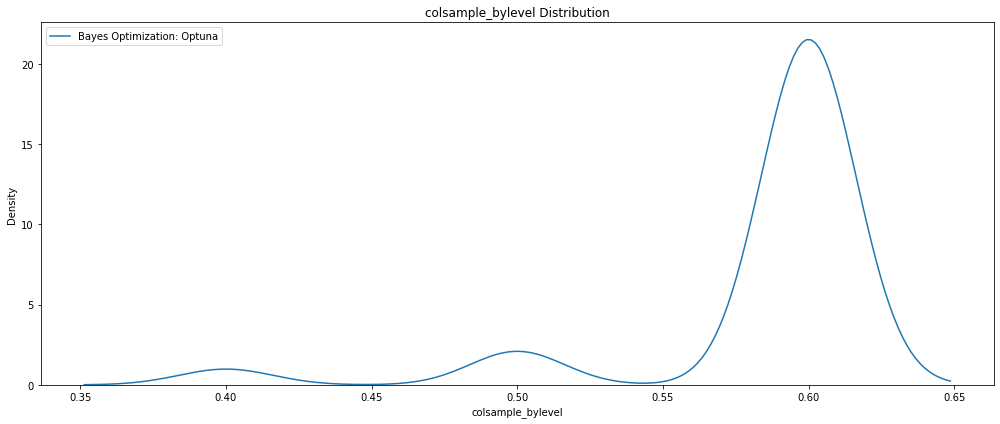

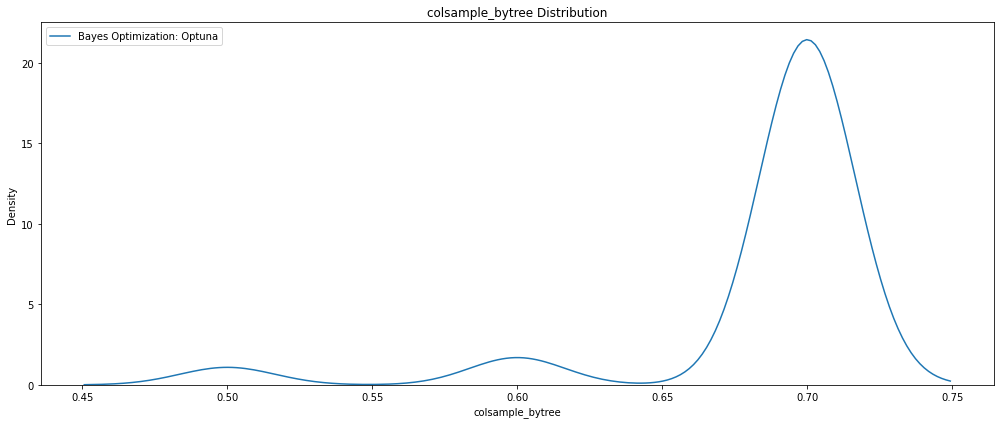

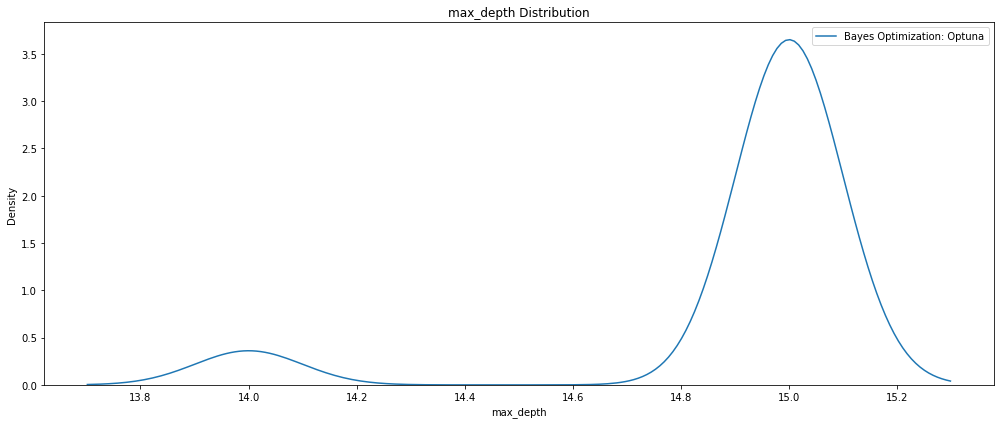

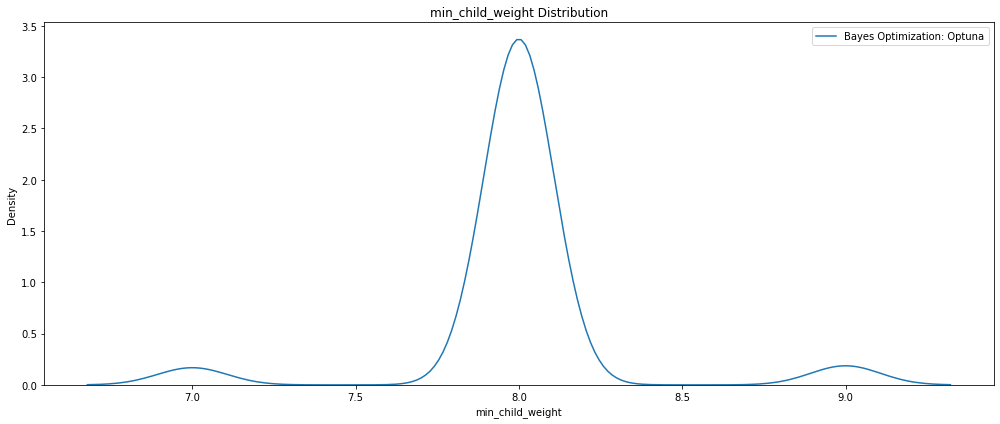

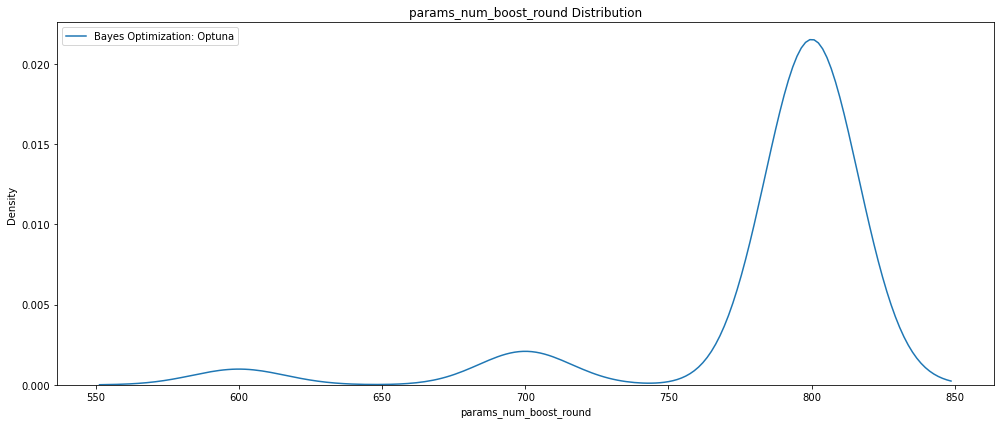

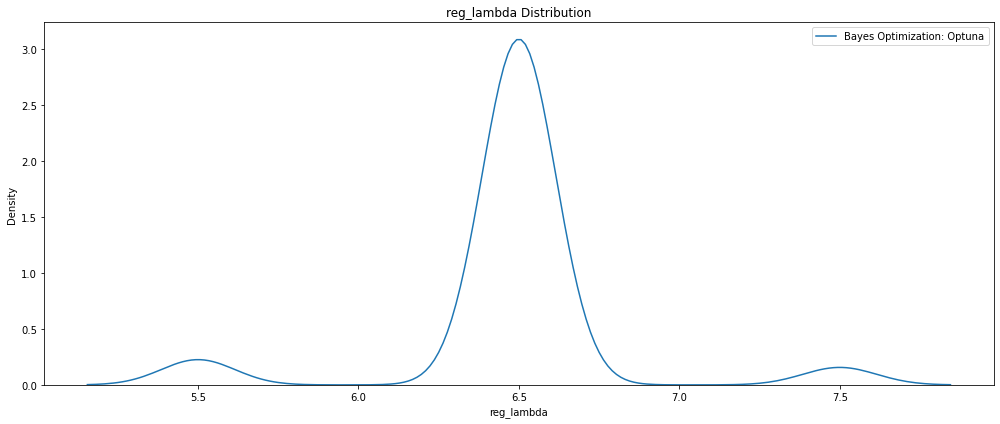

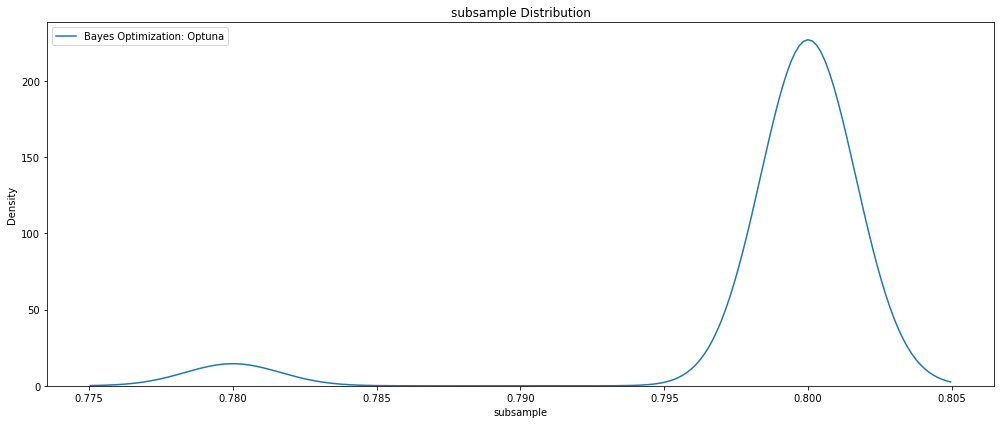

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

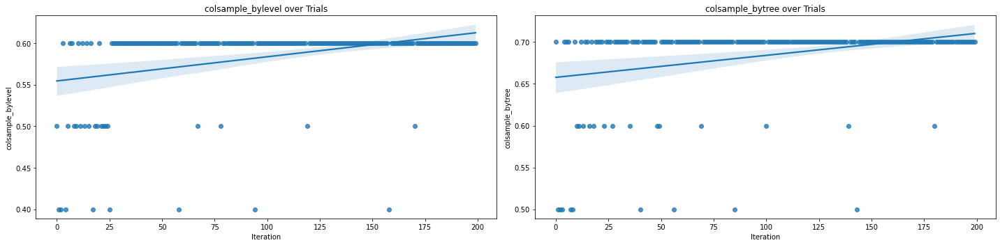

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_3CV_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'num_boost_round': 800,
 'max_depth': 15,
 'subsample': 0.8,
 'reg_lambda': 6.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.6,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials300_GPU_setParams_RTX4000_3CV_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials300_GPU_setParams_RTX4000_3CV_cuml_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1762.822, test: 1886.988
MSE train: 5735179.124, test: 6538285.171
RMSE train: 2394.823, test: 2557.007
R^2 train: 0.938, test: 0.928


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6538285.17141 MSE on the test set.
This was achieved using these conditions:
iteration                                         99
rmse                                     2830.049642
datetime_start            2023-03-02 00:42:33.333198
datetime_complete         2023-03-02 00:42:47.560224
duration                      0 days 00:00:14.227026
colsample_bylevel                                0.6
colsample_bytree                                 0.7
max_depth                                         15
min_child_weight                                   8
params_num_boost_round                           800
reg_lambda                                       6.5
subsample                                        0.8
state                                       COMPLETE
Name: 99, dtype: object


## 200 Trials 5CV

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_RTX4000_5CV_cuml',
                'tags': 'xgbGPU_setParams_RTX4000_5CV_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'n_estimators': trial.suggest_int('num_boost_round', 600, 800, 
                                          step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()

    # Cross validation
    cv_results = xgb.cv(params_xgb_optuna, dtrain, nfold=5, 
                        metrics='rmse')
    run_time = timer() - start

    # Extract best score
    rmse = asnumpy(cv_results['test-rmse-mean'].values[-1])
    print('- Trial RMSE:', rmse) 
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-02-28 14:44:48.093429


- Trial RMSE: 2849.2115722000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2832.8250002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2821.5219726000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2857.5484864


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2796.2029295999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2872.5069334


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2833.7951662


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2891.2872559999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2872.0834962


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2862.575244


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2861.3503418


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2819.8029785999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2821.2173828


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2833.8507812


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2819.8029785999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2845.7503908


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2821.2173828


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2830.48125


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2845.7503908


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2828.8417968000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2804.867285


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.7561524000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2803.8274416


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2808.5771972000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2797.9538576


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2810.5720704000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2797.6026854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.7561524000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2833.8104492


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2847.574707


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2797.1265133999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2796.2029295999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2822.1476074


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2816.9489258000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2819.8063964000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2804.867285


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2819.8029785999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2909.1721192


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2810.5720704000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.7561524000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2797.6026854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2819.8029785999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2828.4715822000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2804.867285


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2814.7460938


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2847.574707


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2819.8029785999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2816.9489258000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2802.7234375999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2822.1476074


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2797.1265133999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2804.867285


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2847.574707


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2816.9489258000003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2802.7234375999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2819.8029785999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2797.1265133999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2796.2029295999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2818.7561524000002


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2795.958252


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Start Time           2023-02-28 14:44:48.093429
End Time             2023-02-28 15:56:49.418113
1:12:01


Number of finished trials: 200
Best trial: {'num_boost_round': 700, 'max_depth': 15, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.6, 'min_child_weight': 8}
Lowest RMSE 2795.958252


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
99          99  2795.958252 2023-02-28 15:20:21.171642   
124        124  2795.958252 2023-02-28 15:29:31.269482   
125        125  2795.958252 2023-02-28 15:29:52.339900   
126        126  2795.958252 2023-02-28 15:30:18.475476   
127        127  2795.958252 2023-02-28 15:30:39.647347   
..         ...          ...                        ...   
9            9  2862.575244 2023-02-28 14:48:00.203020   
8            8  2872.083496 2023-02-28 14:47:40.127103   
5            5  2872.506933 2023-02-28 14:46:39.633133   
7            7  2891.287256 2023-02-28 14:47:19.982933   
59          59  2909.172119 2023-02-28 15:05:49.470613   

             datetime_complete               duration  colsample_bylevel  \
99  2023-02-28 15:20:38.003057 0 days 00:00:16.831415                0.6   
124 2023-02-28 15:29:48.118041 0 days 00:00:16.848559                0.6   
125 2023-02-28 15:30:09.532971 0 days 00:00:17.193071                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.html')
fig.show()

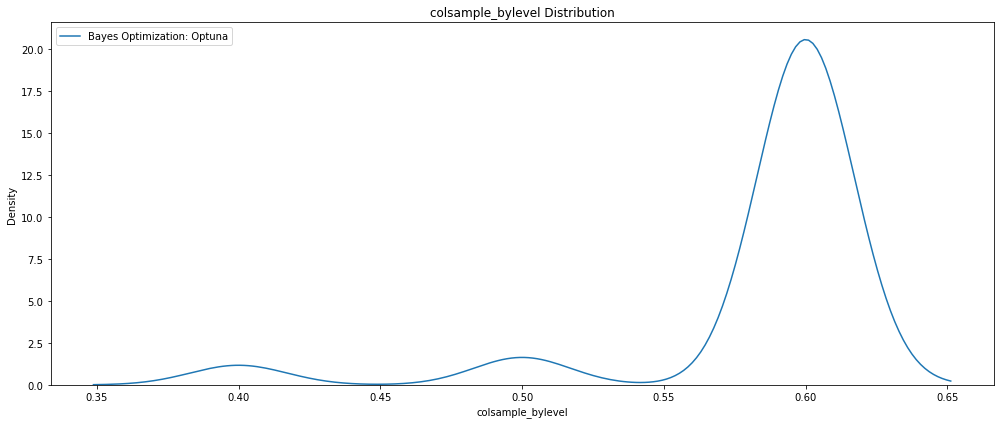

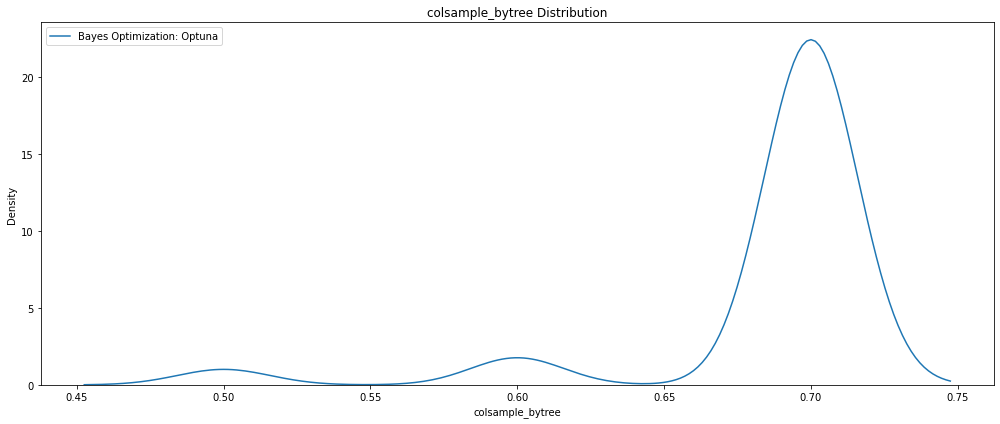

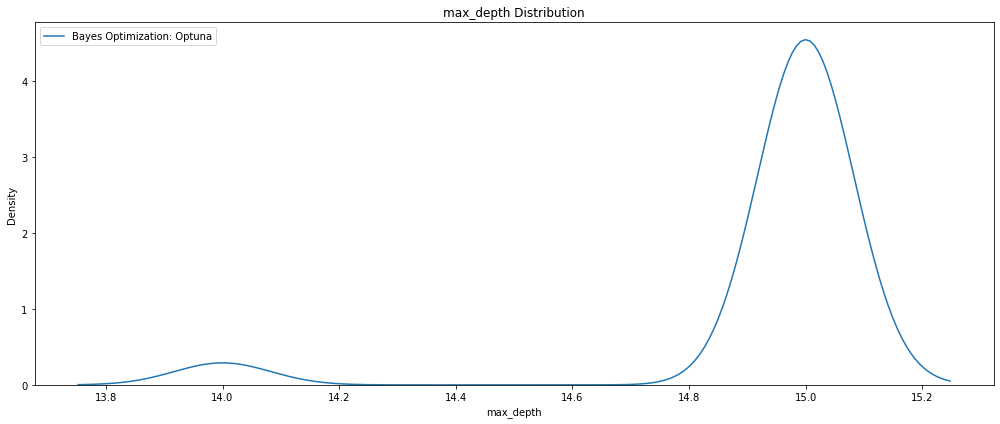

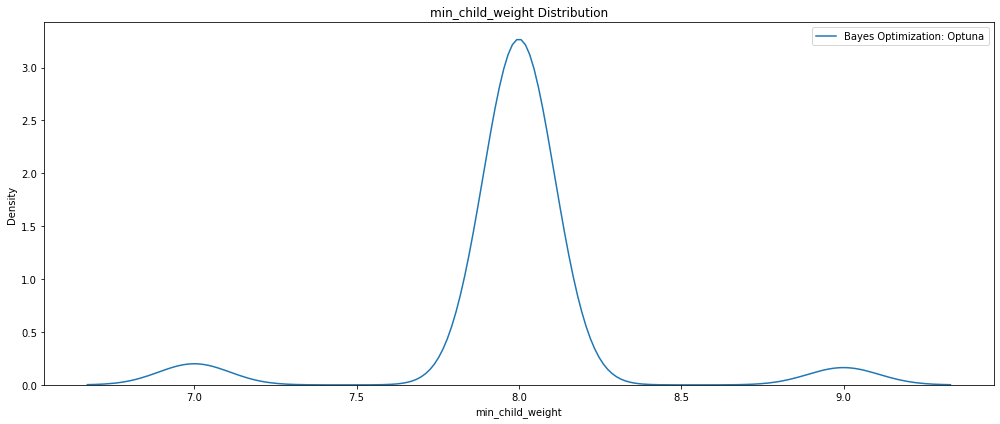

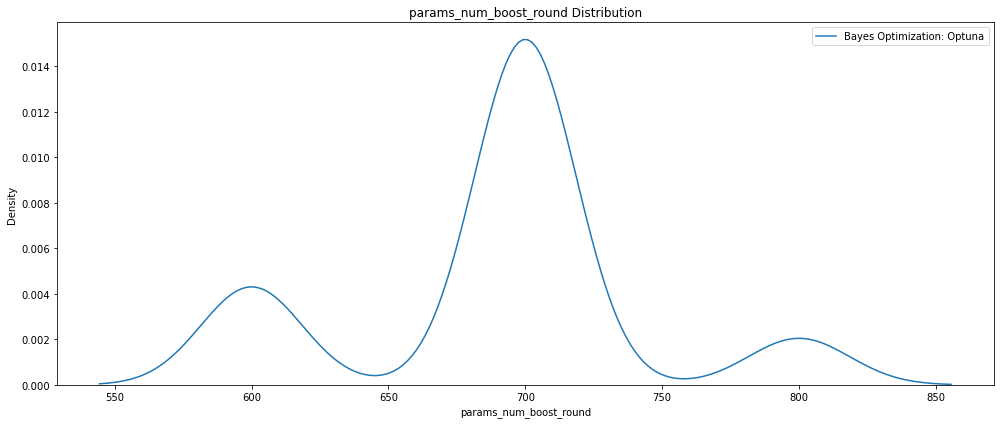

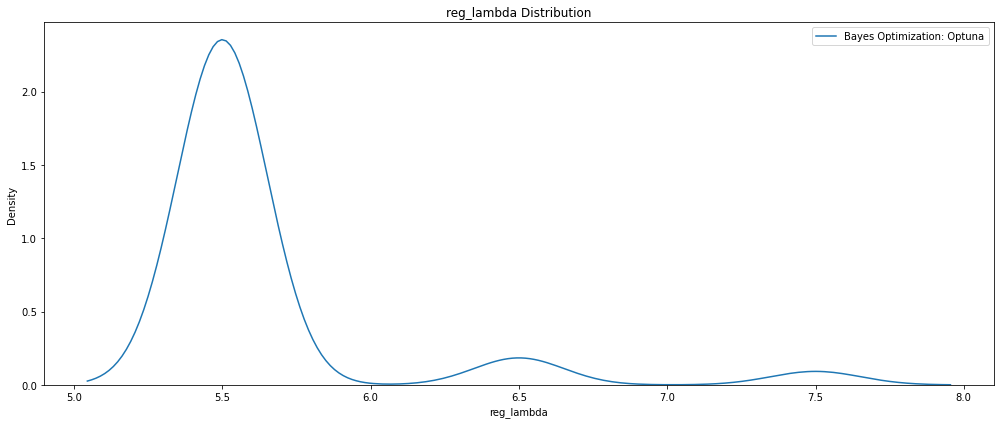

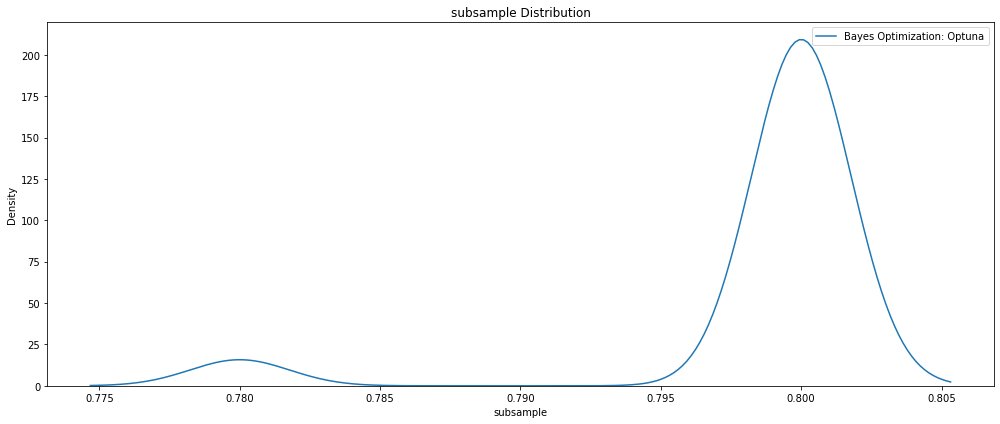

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

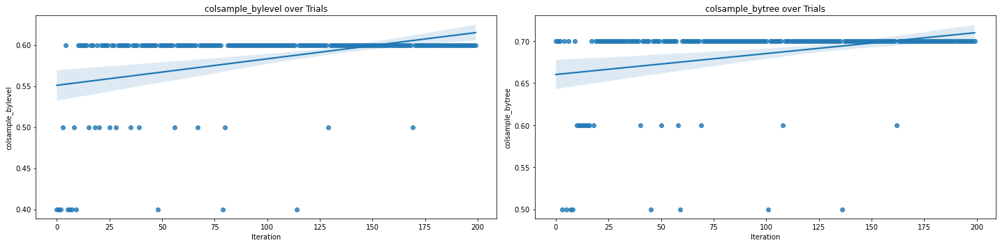

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_5CV_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'num_boost_round': 700,
 'max_depth': 15,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.6,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials300_GPU_setParams_RTX4000_5CV_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials300_GPU_setParams_RTX4000_5CV_cuml_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1745.962, test: 1879.259
MSE train: 5633745.232, test: 6482116.496
RMSE train: 2373.551, test: 2546.000
R^2 train: 0.939, test: 0.929


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6482116.49609 MSE on the test set.
This was achieved using these conditions:
iteration                                         99
rmse                                     2795.958252
datetime_start            2023-02-28 15:20:21.171642
datetime_complete         2023-02-28 15:20:38.003057
duration                      0 days 00:00:16.831415
colsample_bylevel                                0.6
colsample_bytree                                 0.7
max_depth                                         15
min_child_weight                                   8
params_num_boost_round                           700
reg_lambda                                       5.5
subsample                                        0.8
state                                       COMPLETE
Name: 99, dtype: object


## 200 Trials 10CV

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_RTX4000_10CV_cuml',
                'tags': 'xgbGPU_setParams_RTX4000_10CV_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'n_estimators': trial.suggest_int('num_boost_round', 600, 800, 
                                          step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }

    # Start timer for each trial
    start = timer()

    # Cross validation
    cv_results = xgb.cv(params_xgb_optuna, dtrain, nfold=10, 
                        metrics='rmse')
    run_time = timer() - start

    # Extract best score
    rmse = asnumpy(cv_results['test-rmse-mean'].values[-1])
    print('- Trial RMSE:', rmse) 
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-03-01 03:36:22.256324


- Trial RMSE: 2819.8660155999996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2875.8192627


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2819.0229736


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2819.0553222999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2845.3189942


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2918.2776123


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


- Trial RMSE: 2815.6239502


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2813.4910889


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2824.6767089


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2807.7410158


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2822.7574219999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2782.0489991000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2870.2139159999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2805.3928466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2801.1309815


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2794.5093507000006


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2822.7574219999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2807.3624512


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2800.9214110999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2786.9071533


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2786.9071533


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2782.0489991000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2800.9214110999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2831.0988037


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2832.8914062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2804.0033692


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2820.3410645999998


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2799.119751


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2786.9071533


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2822.6331056000004


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2807.1624512


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2788.6581787


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2856.1445312000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2809.8863281


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.3928466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2786.9071533


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2801.1309815


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2786.9071533


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2805.3928466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2781.1714845


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2814.2343996


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2827.7138182999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2809.1802978000005


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2788.6577636


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2829.374585


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2799.119751


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2782.4336912999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2793.6202392999994


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2827.7138182999997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2788.6577636


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2784.2882325


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


- Trial RMSE: 2779.5969726


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Start Time           2023-03-01 03:36:22.256324
End Time             2023-03-01 05:07:01.810225
1:30:39


Number of finished trials: 200
Best trial: {'num_boost_round': 800, 'max_depth': 15, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.6, 'min_child_weight': 8}
Lowest RMSE 2779.5969726


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
99          99  2779.596973 2023-03-01 04:21:05.837371   
123        123  2779.596973 2023-03-01 04:32:04.899252   
124        124  2779.596973 2023-03-01 04:32:31.905454   
125        125  2779.596973 2023-03-01 04:32:58.923757   
126        126  2779.596973 2023-03-01 04:33:25.987929   
..         ...          ...                        ...   
4            4  2845.318994 2023-03-01 03:38:02.492300   
50          50  2856.144531 2023-03-01 03:58:26.023370   
17          17  2870.213916 2023-03-01 03:43:40.809645   
1            1  2875.819263 2023-03-01 03:36:48.090838   
5            5  2918.277612 2023-03-01 03:38:26.544612   

             datetime_complete               duration  colsample_bylevel  \
99  2023-03-01 04:21:29.309840 0 days 00:00:23.472469                0.6   
123 2023-03-01 04:32:27.672937 0 days 00:00:22.773685                0.6   
124 2023-03-01 04:32:54.467968 0 days 00:00:22.562514                0.6   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.html')
fig.show()

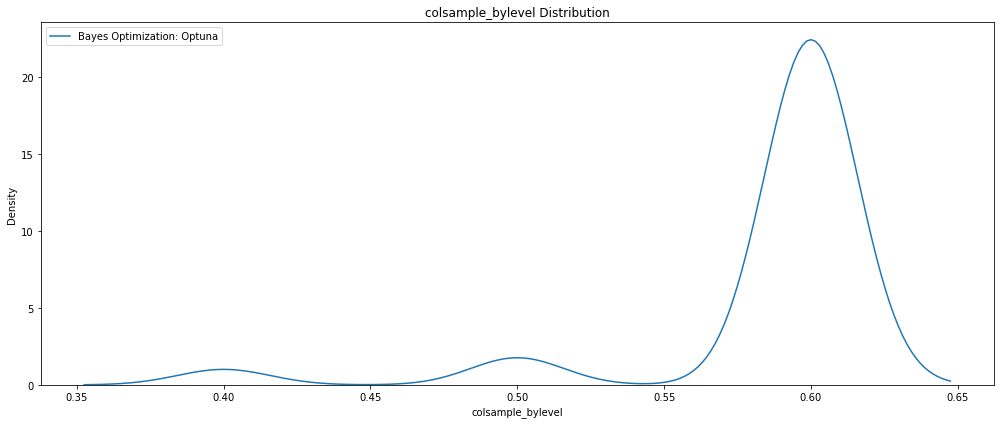

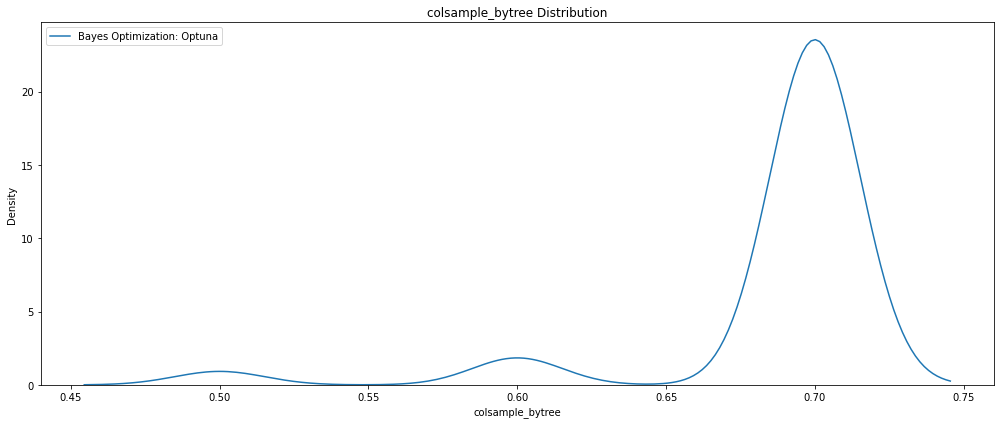

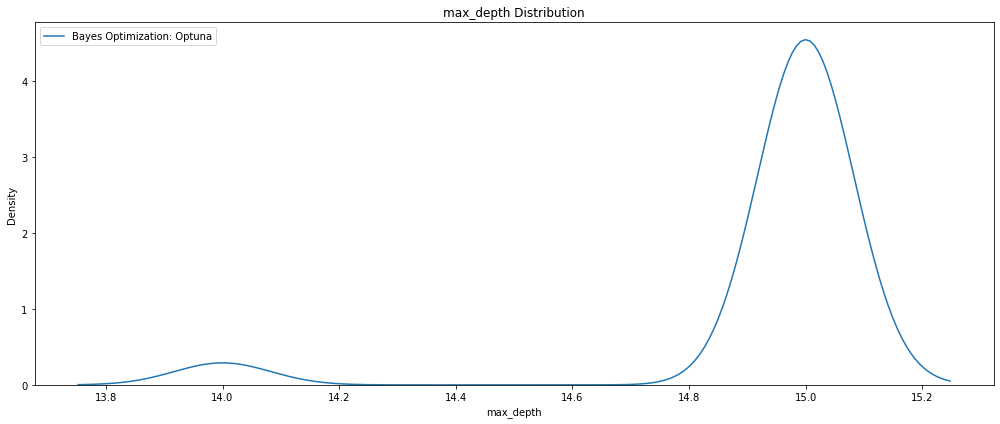

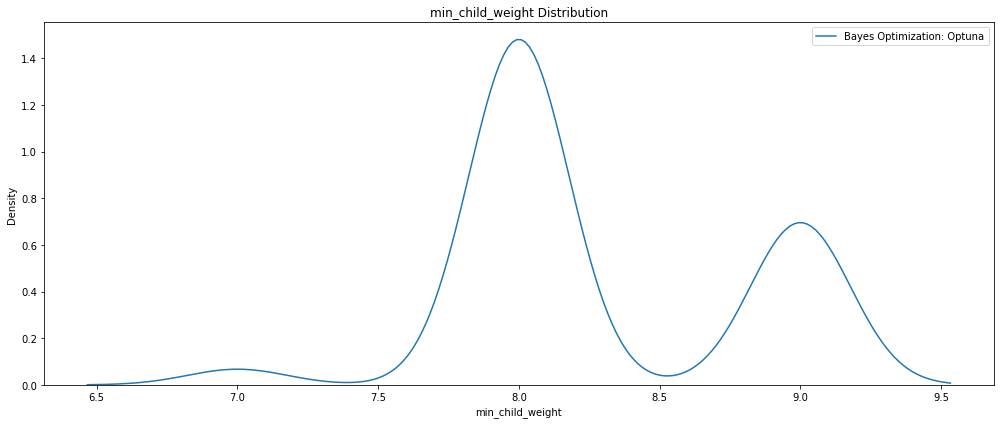

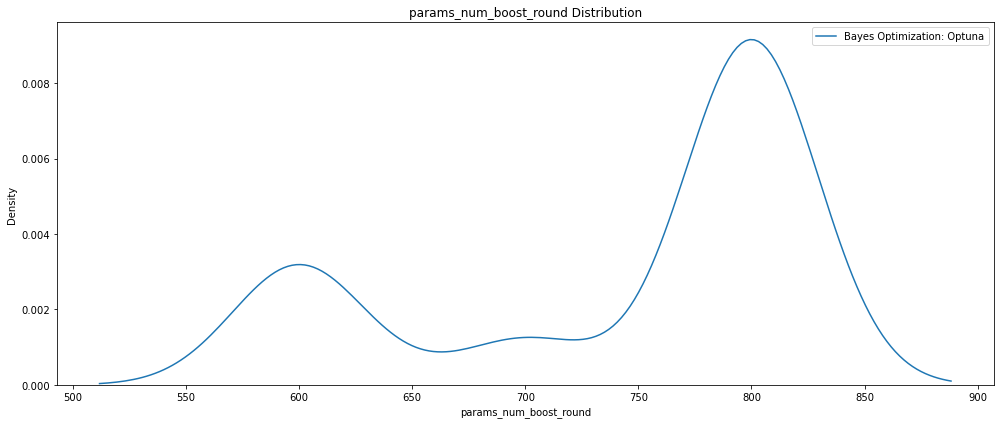

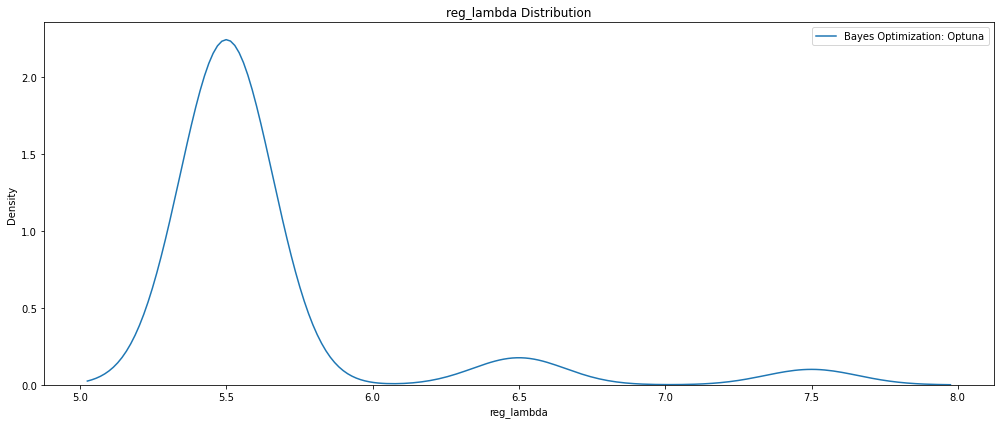

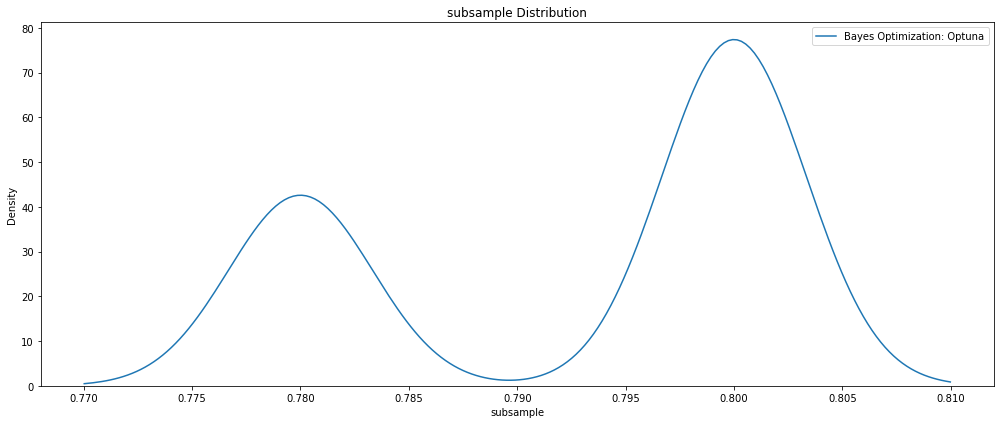

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

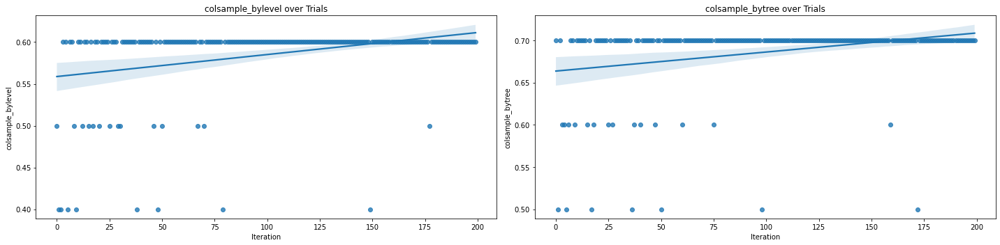

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_10CV_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'num_boost_round': 800,
 'max_depth': 15,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.6,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials300_GPU_setParams_RTX4000_10CV_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials300_GPU_setParams_RTX4000_10CV_cuml_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1745.962, test: 1879.259
MSE train: 5633745.232, test: 6482116.496
RMSE train: 2373.551, test: 2546.000
R^2 train: 0.939, test: 0.929


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6482116.49609 MSE on the test set.
This was achieved using these conditions:
iteration                                         99
rmse                                     2779.596973
datetime_start            2023-03-01 04:21:05.837371
datetime_complete         2023-03-01 04:21:29.309840
duration                      0 days 00:00:23.472469
colsample_bylevel                                0.6
colsample_bytree                                 0.7
max_depth                                         15
min_child_weight                                   8
params_num_boost_round                           800
reg_lambda                                       5.5
subsample                                        0.8
state                                       COMPLETE
Name: 99, dtype: object


# Train/Test

## 200 Trials Train/Test Scikit-Learn

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_RTX4000_trainTest_cuml',
                'tags': 'xgbGPU_setParams_RTX4000_trainTest_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'n_estimators': trial.suggest_int('num_boost_round', 600, 800, 
                                          step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()

    # Define model type   
    model = XGBRegressor(objective='reg:squarederror',
                         booster='gbtree', 
                         tree_method='gpu_hist',
                         gamma=4.5,
                         learning_rate=0.04,
                         reg_alpha=0.01,
                         scale_pos_weight=1,
                         use_label_encoder=False,
                         random_state=seed_value,
                         verbosity=0,
                         **params_xgb_optuna)
      
    # Train the model
    model.fit(train_features, train_label, 
              eval_set = [(test_features, test_label), 
                          (train_features, train_label)],
              verbose=False) 
    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(test_features)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-02-28 20:08:42.483676


Trial RMSE: 2330.4610606474266


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2332.819234222356


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2324.147127950814


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2320.4806784035177


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2318.4678306918545


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2328.208191983747


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2323.6465133805696


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2319.7158646272956


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2319.256182712584


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2324.5604759976236


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2319.3833025490035


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.0975722163694


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2318.7807104690924


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2316.441373634785


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.441373634785


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2319.718629019506


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2315.459581618446


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2322.6220488706804


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2322.3328729603063


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2318.516399908505


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2320.2470362616577


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2319.031787693042


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2320.2125609583454


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2318.616181780741


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2319.169679659003


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2316.5709761922744


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2317.4557781318435


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2323.22015170431


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2318.2460558862526


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2327.3859186566397


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2319.532897826591


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2323.7222579241466


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2323.1461427398835


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2316.593045230496


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2317.7091557934286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2319.623249186997


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2320.4959300710675


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.273270276269


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2319.031787693042


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2321.0445873393155


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2316.1813790006872


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2320.4959300710675


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.7091557934286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2321.550548705832


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2317.5951793682775


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.677899152059


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2319.3948909862183


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.677899152059


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.677899152059


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2321.0546535177923


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2323.4275561257855


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2318.7807104690924


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2319.816013514285


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2319.3948909862183


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2317.677899152059


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2316.133184393459


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2318.9016222849286


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2323.752540260281


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2315.713146894065


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2323.752540260281


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2318.8319418708866


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


In [ ]:
# Load to continue training
study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl')

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Number of finished trials: 192
Best trial: {'num_boost_round': 800, 'max_depth': 15, 'subsample': 0.78, 'reg_lambda': 7.5, 'colsample_bytree': 0.6, 'colsample_bylevel': 0.5, 'min_child_weight': 7}
Lowest RMSE 2314.3526373248087


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=9, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-03-01 02:11:13.022662


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2314.3526373248087


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
num_boost_round,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Start Time           2023-03-01 02:11:13.022662
End Time             2023-03-01 02:28:18.034831
0:17:05


Number of finished trials: 201
Best trial: {'num_boost_round': 800, 'max_depth': 15, 'subsample': 0.78, 'reg_lambda': 7.5, 'colsample_bytree': 0.6, 'colsample_bylevel': 0.5, 'min_child_weight': 7}
Lowest RMSE 2314.3526373248087


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
200        200  2314.352637 2023-03-01 02:26:24.387685   
141        141  2314.352637 2023-03-01 00:31:35.184923   
140        140  2314.352637 2023-03-01 00:29:40.857814   
139        139  2314.352637 2023-03-01 00:27:48.224954   
138        138  2314.352637 2023-03-01 00:25:54.033331   
..         ...          ...                        ...   
36          36  2327.385919 2023-02-28 21:07:01.730154   
5            5  2328.208192 2023-02-28 20:15:11.921127   
0            0  2330.461061 2023-02-28 20:08:42.485291   
1            1  2332.819234 2023-02-28 20:09:44.427772   
191        191          NaN 2023-03-01 02:05:26.594975   

             datetime_complete               duration  colsample_bylevel  \
200 2023-03-01 02:28:13.336106 0 days 00:01:48.948421                0.5   
141 2023-03-01 00:33:23.681103 0 days 00:01:48.496180                0.5   
140 2023-03-01 00:31:30.465634 0 days 00:01:49.607820                0.5   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.html')
fig.show()

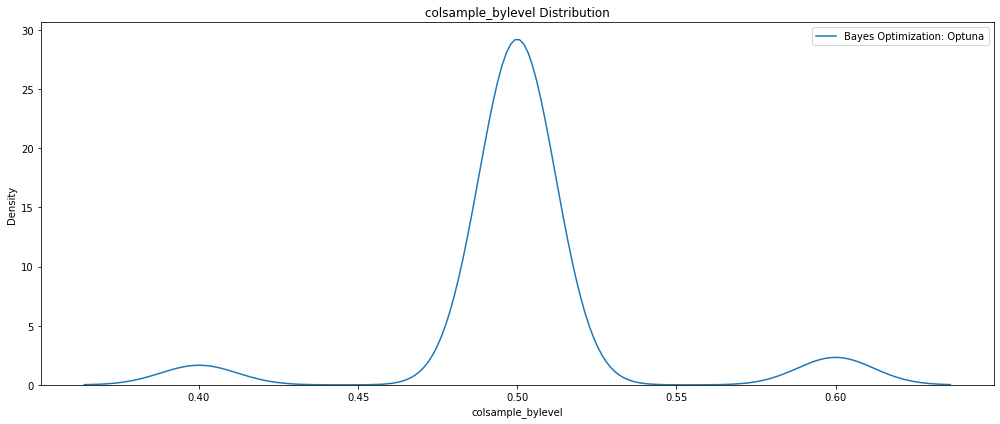

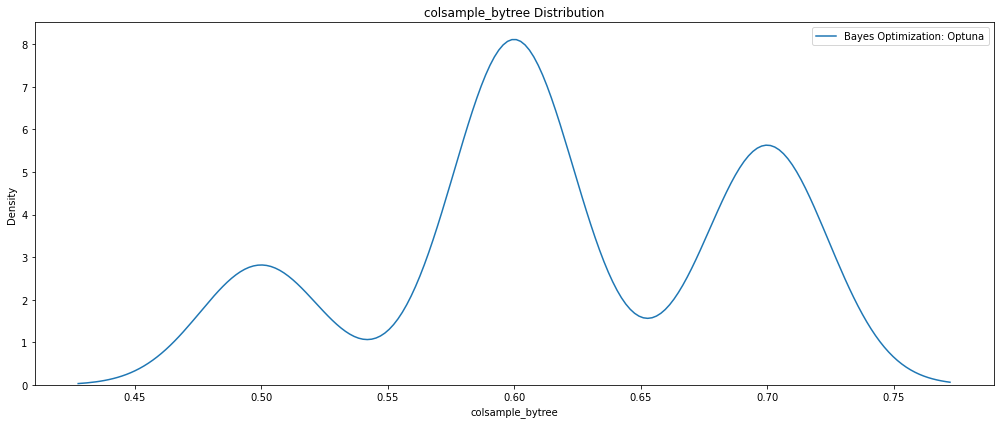

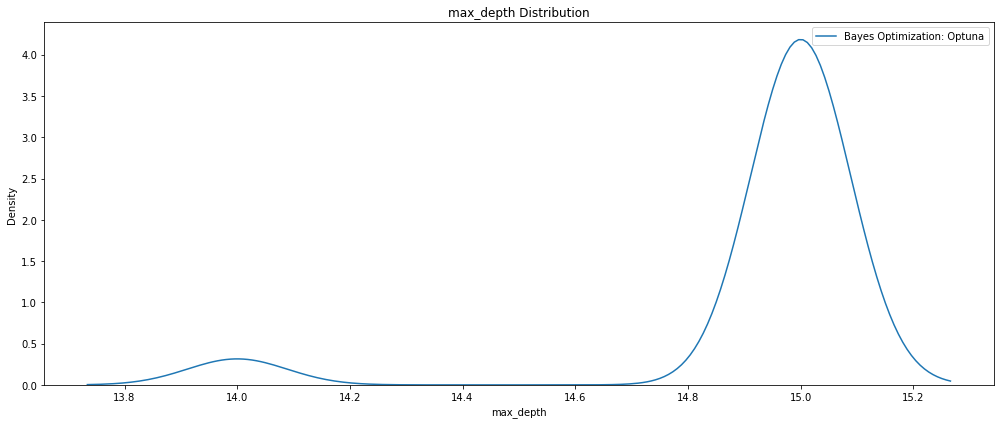

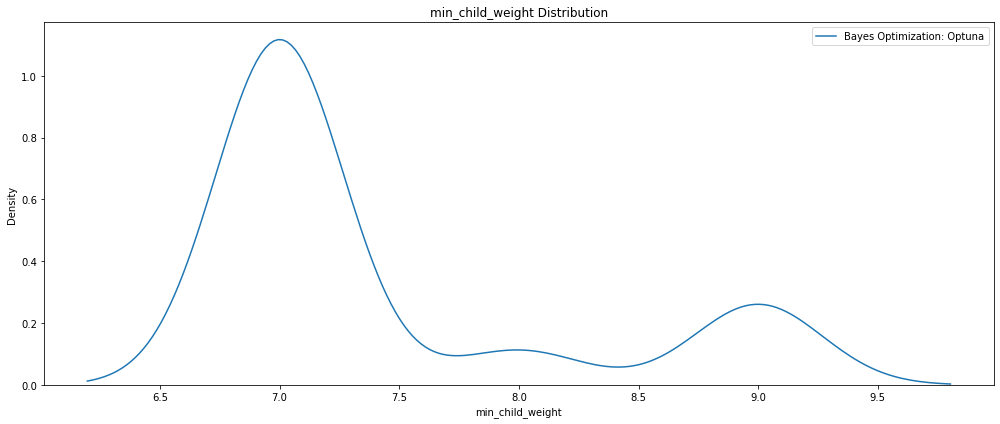

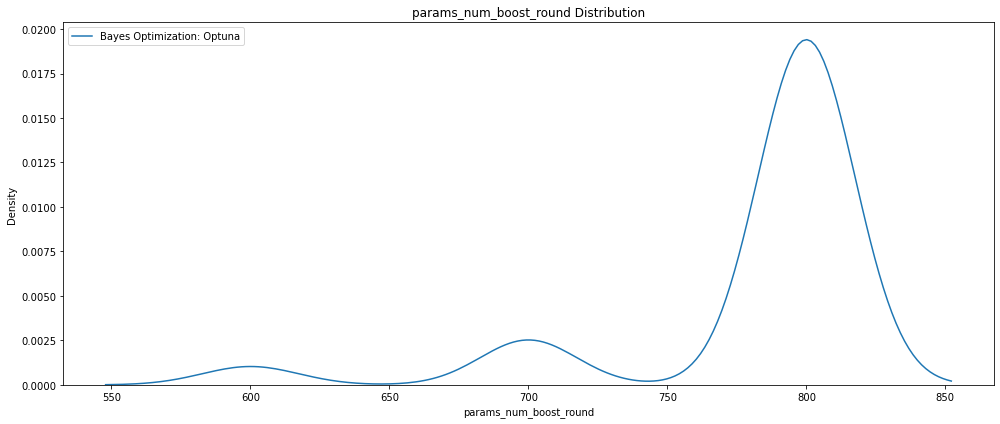

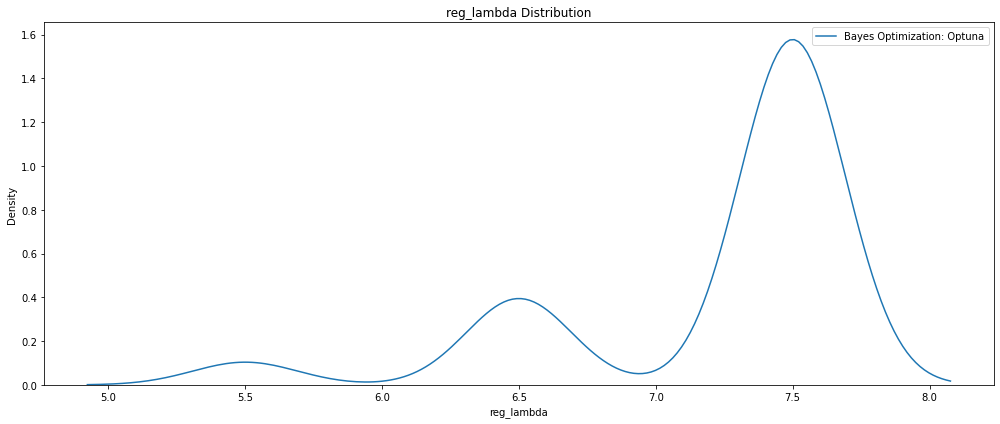

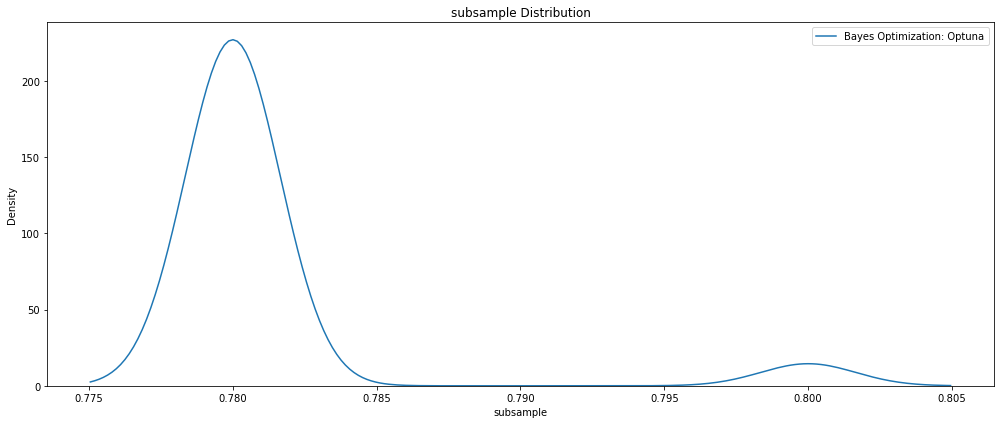

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

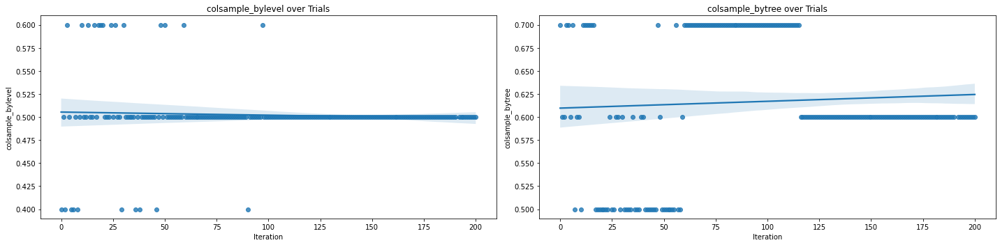

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'num_boost_round': 800,
 'max_depth': 15,
 'subsample': 0.78,
 'reg_lambda': 7.5,
 'colsample_bytree': 0.6,
 'colsample_bylevel': 0.5,
 'min_child_weight': 7,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials300_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials300_GPU_setParams_RTX4000_trainTest_cuml_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1805.864, test: 1908.223
MSE train: 5988845.779, test: 6666630.478
RMSE train: 2447.212, test: 2581.982
R^2 train: 0.935, test: 0.927


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6666630.47833 MSE on the test set.
This was achieved using these conditions:
iteration                                        200
rmse                                     2314.352637
datetime_start            2023-03-01 02:26:24.387685
datetime_complete         2023-03-01 02:28:13.336106
duration                      0 days 00:01:48.948421
colsample_bylevel                                0.5
colsample_bytree                                 0.6
max_depth                                       15.0
min_child_weight                                 7.0
params_num_boost_round                         800.0
reg_lambda                                       7.5
subsample                                       0.78
state                                       COMPLETE
Name: 200, dtype: object


## 200 Trials Train/Test DMatrix

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_xgbGPU_setParams', 
                'save_code': 'False', 
                'notes': 'xgbGPU_setParams_RTX4000_trainTest_DMatrix_cuml',
                'tags': 'xgbGPU_setParams_RTX4000_trainTest_DMatrix_cuml'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    """
    Objective function to tune a `XGBoostRegressor` model.
    """
    joblib.dump(study, 'XGB_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.pkl')

    # Define parameter grid
    params_xgb_optuna = {
        'objective':'reg:squarederror',
        'booster':'gbtree',
        'gpu_id': 0,
        'tree_method': 'gpu_hist',
        'gamma': 4.5,
        'learning_ratel': 0.04,
        'reg_alpha': 0.01,
        'scale_pos_weight': 1,
        'use_label_encoder': False,
        'random_state': seed_value,
        'verbosity': 0,
        'verbose': False,
        'n_estimators': trial.suggest_int('n_estimators', 600, 800, step=100),
        'max_depth': trial.suggest_int('max_depth', 14, 15),
        'subsample': trial.suggest_float('subsample', 0.78, 0.8, step=0.02),
        'reg_lambda': trial.suggest_float('reg_lambda', 5.5, 7.5, step=1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 0.7, 
                                                step=0.1),
        'colsample_bylevel': trial.suggest_float('colsample_bylevel', 0.4, 0.6, 
                                                 step=0.1), 
        'min_child_weight': trial.suggest_int('min_child_weight', 7, 9, step=1)
        }
    
    # Start timer for each trial
    start = timer()

    # Train the model# Train the model
    model = xgb.train(params_xgb_optuna, dtrain)

    run_time = timer() - start

    # Predictions
    y_pred_val = model.predict(dtest)
    rmse = mean_squared_error(asnumpy(test_label), asnumpy(y_pred_val), 
                              squared=False)
    print('Trial RMSE:', rmse)
        
    return rmse       

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('XGB_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.pkl'):
    study = joblib.load('XGB_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=200, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-03-01 02:36:12.779900


Trial RMSE: 2817.2768808221435


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2823.965174939302


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2871.81349429561


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2825.487739775991


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.6


Trial RMSE: 2789.7890152104887


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2847.6957757612045


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2827.0408507047573


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2823.965174939302


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2815.5365150491966


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2817.1271582092922


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2770.8047542986915


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2770.8047542986915


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2766.9362882837218


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2821.42378365304


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.5


Trial RMSE: 2766.9362882837218


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2776.7794255749886


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2777.9211142982513


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2821.808181187847


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2783.4202588674293


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2837.6095613203197


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2766.9362882837218


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2766.9362882837218


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2766.9362882837218


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2766.9362882837218


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.6
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2776.5340967802244


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2797.2636338884217


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2807.779258321462


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2776.5340967802244


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2800.6865439196054


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2781.5173655083854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2827.0408507047573


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.6


Trial RMSE: 2841.7539765698825


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.5


Trial RMSE: 2818.8795119455062


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2770.8047542986915


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2811.2940644111127


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2797.2636338884217


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2784.458820314303


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2797.4847403509148


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.4
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2797.2636338884217


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2821.808181187847


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2802.161004333322


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2781.5173655083854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2763.5970643923038


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2785.0322064110405


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2797.2636338884217


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2781.5173655083854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2821.808181187847


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2804.050484194246


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2797.2636338884217


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2776.7794255749886


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2781.5173655083854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2781.2413765406254


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2821.808181187847


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.5


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2802.161004333322


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2797.2636338884217


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.6


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2781.5173655083854


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2762.6793216888777


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Trial RMSE: 2776.7794255749886


colsample_bylevel,▁
colsample_bytree,▁
max_depth,▁
min_child_weight,▁
n_estimators,▁
reg_lambda,▁
subsample,▁
trial_number,▁
value,▁
colsample_bylevel,0.5
colsample_bytree,0.7


Start Time           2023-03-01 02:36:12.779900
End Time             2023-03-01 03:31:53.950927
0:55:41


Number of finished trials: 200
Best trial: {'n_estimators': 600, 'max_depth': 15, 'subsample': 0.8, 'reg_lambda': 5.5, 'colsample_bytree': 0.7, 'colsample_bylevel': 0.5, 'min_child_weight': 8}
Lowest RMSE 2762.6793216888777


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_colsample_bylevel': 'colsample_bylevel'}, 
                 inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_gamma': 'gamma'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_weight': 'min_child_weight'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_reg_alpha': 'reg_alpha'}, inplace=True)
trials_df.rename(columns={'params_reg_lambda': 'reg_lambda'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.csv', 
                 index=False)
print(trials_df) 

     iteration         rmse             datetime_start  \
99          99  2762.679322 2023-03-01 03:03:07.239986   
198        198  2762.679322 2023-03-01 03:31:21.313166   
100        100  2762.679322 2023-03-01 03:03:23.299652   
101        101  2762.679322 2023-03-01 03:03:39.315749   
102        102  2762.679322 2023-03-01 03:03:55.433045   
..         ...          ...                        ...   
38          38  2827.040851 2023-03-01 02:46:30.861878   
20          20  2837.609561 2023-03-01 02:41:35.725402   
39          39  2841.753977 2023-03-01 02:46:46.955180   
5            5  2847.695776 2023-03-01 02:37:31.219537   
2            2  2871.813494 2023-03-01 02:36:43.302704   

             datetime_complete               duration  colsample_bylevel  \
99  2023-03-01 03:03:18.993118 0 days 00:00:11.753132                0.5   
198 2023-03-01 03:31:33.189076 0 days 00:00:11.875910                0.5   
100 2023-03-01 03:03:35.054647 0 days 00:00:11.754995                0.5   

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparamters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['min_child_weight', 
                                                       'max_depth'])
py.plot(fig, filename='contour_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.html')
fig.show()

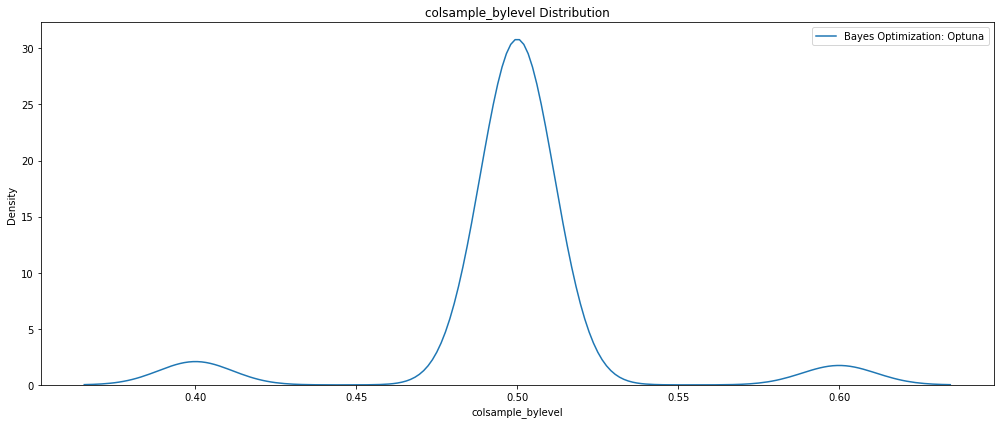

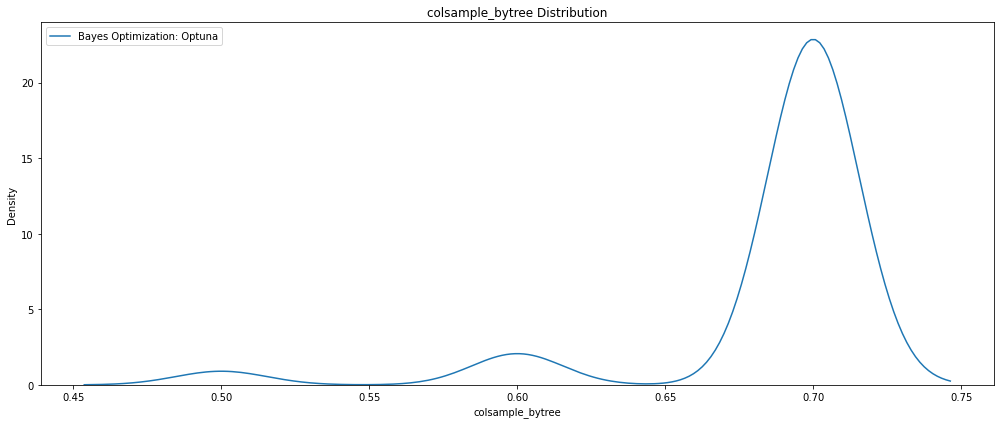

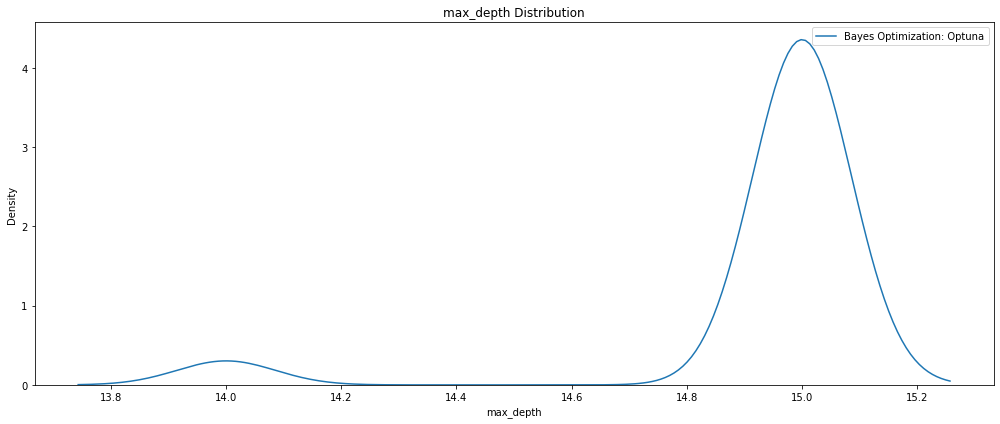

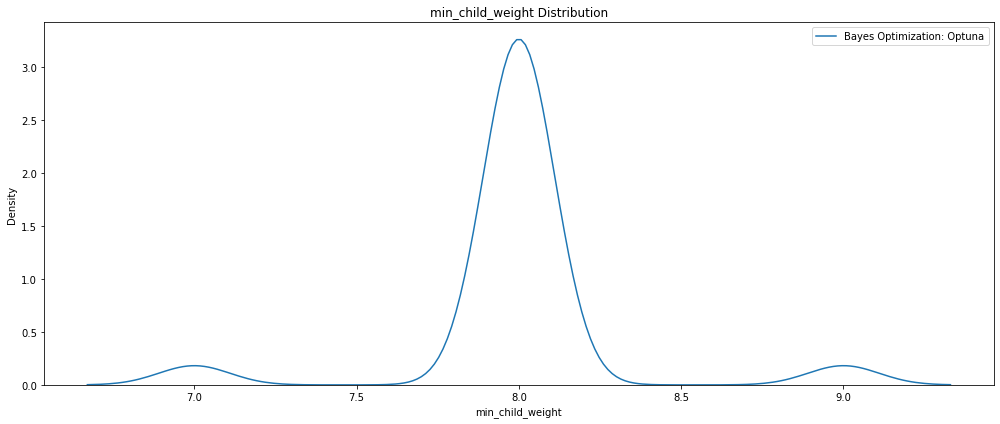

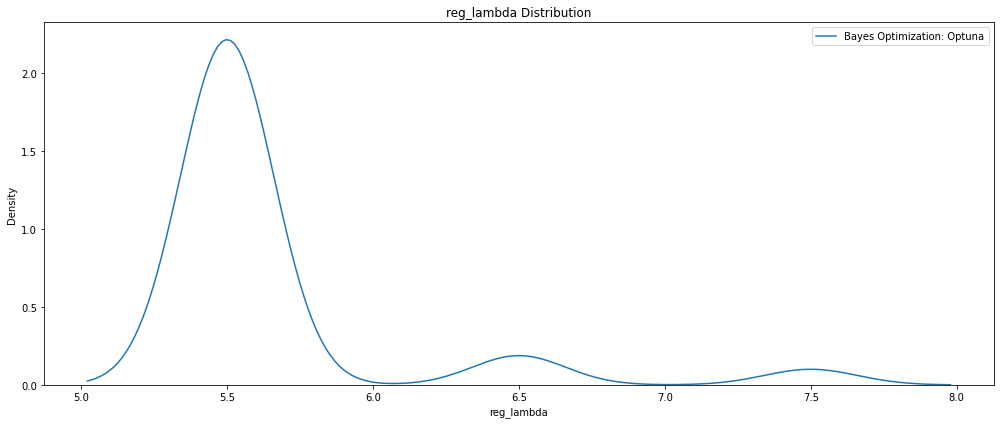

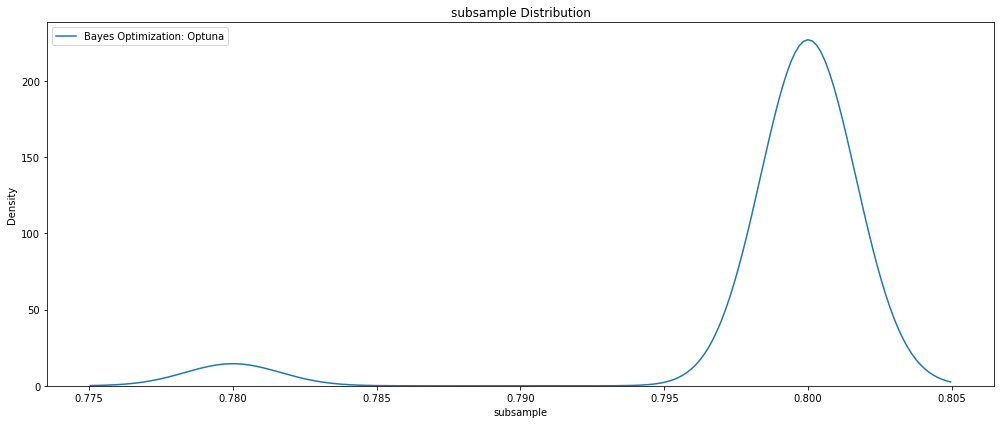

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

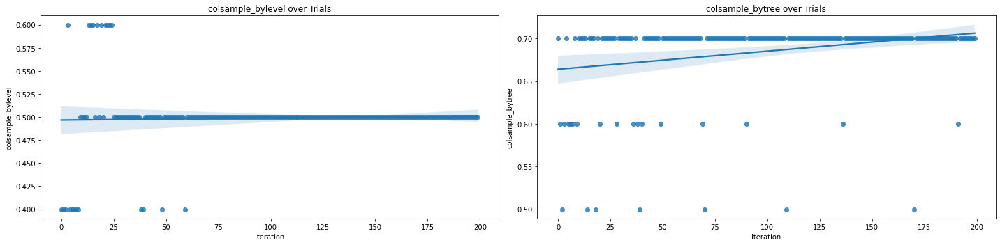

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['colsample_bylevel', 'colsample_bytree']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_XGBoost_Optuna_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 600,
 'max_depth': 15,
 'subsample': 0.8,
 'reg_lambda': 5.5,
 'colsample_bytree': 0.7,
 'colsample_bylevel': 0.5,
 'min_child_weight': 8,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/XGBoost/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = XGBRegressor(objective='reg:squarederror', 
                          booster='gbtree',
                          tree_method='gpu_hist',
                          gpu_id=0,
                          gamma=4.5,
                          learning_rate=0.04,
                          reg_alpha=0.01,
                          scale_pos_weight=1,
                          use_label_encoder=False,
                          verbosity=0, 
                          **params)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'XGB_Optuna_trials300_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('XGB_Optuna_trials300_GPU_setParams_RTX4000_trainTest_DMatrix_cuml_wb.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for XGBoost HPO GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_absolute_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred)),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred))))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(asnumpy(train_label), asnumpy(y_train_pred), 
                           squared=False),
        mean_squared_error(asnumpy(test_label), asnumpy(y_test_pred), 
                           squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(asnumpy(train_label), asnumpy(y_train_pred)),
        r2_score(asnumpy(test_label), asnumpy(y_test_pred))))


Model Metrics for XGBoost HPO GPU trials
MAE train: 1056.376, test: 1690.577
MSE train: 2117904.858, test: 5389903.354
RMSE train: 1455.302, test: 2321.617
R^2 train: 0.977, test: 0.941


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(asnumpy(test_label), 
                                                                                                      asnumpy(y_test_pred))))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 5389903.35376 MSE on the test set.
This was achieved using these conditions:
iteration                                    99
rmse                                2762.679322
datetime_start       2023-03-01 03:03:07.239986
datetime_complete    2023-03-01 03:03:18.993118
duration                 0 days 00:00:11.753132
colsample_bylevel                           0.5
colsample_bytree                            0.7
max_depth                                    15
min_child_weight                              8
n_estimators                                600
reg_lambda                                  5.5
subsample                                   0.8
state                                  COMPLETE
Name: 99, dtype: object
